# Import dependencies

In [26]:
from sagemaker import image_uris, model_uris, script_uris
import sagemaker, boto3, json
from sagemaker import get_execution_role
from sagemaker.estimator import Estimator
from sagemaker.utils import name_from_base
import tarfile
from sagemaker import hyperparameters
from glob import glob
import subprocess
import os

In [27]:
aws_role = get_execution_role()
aws_region = boto3.Session().region_name
sess = sagemaker.Session()

# Get training image_uri

In [28]:
train_model_id, train_model_version, train_scope = "catboost-classification-model", "*", "training"
training_instance_type = "ml.m5.xlarge"

In [29]:
train_model_id, train_model_version, train_scope

('catboost-classification-model', '*', 'training')

In [30]:
train_image_uri = image_uris.retrieve(
    region=None,
    framework=None,
    model_id=train_model_id,
    model_version=train_model_version,
    image_scope=train_scope,
    instance_type=training_instance_type
)

# Retrieve the training script
train_source_uri = script_uris.retrieve(
    model_id=train_model_id, model_version=train_model_version, script_scope=train_scope
)

train_model_uri = model_uris.retrieve(
    model_id=train_model_id, model_version=train_model_version, model_scope=train_scope
)

INFO:sagemaker.image_uris:image_uri is not presented, retrieving image_uri based on instance_type, framework etc.


# Define data & artifacts buckets

In [31]:
training_data_bucket = f"jumpstart-cache-prod-{aws_region}"
training_data_prefix = "training-datasets/tabular_multiclass/"

training_dataset_s3_path = f"s3://{training_data_bucket}/{training_data_prefix}train"
validation_dataset_s3_path = f"s3://{training_data_bucket}/{training_data_prefix}validation"

output_bucket = sess.default_bucket()
output_prefix = "jumpstart-example-tabular-training"

s3_output_location =  f"s3://{output_bucket}/cat-boost-test-pytorch"


# Define hyperparameters and estimator

In [32]:
hyperparameters = hyperparameters.retrieve_default(
    model_id=train_model_id, model_version=train_model_version
)

hyperparameters[
    "iterations"
] = "500"

training_job_name = name_from_base(f"built-in-algo-{train_model_id}-training")

tabular_estimator = Estimator(
    role=aws_role,
    image_uri=train_image_uri,
    source_dir=train_source_uri,
    model_uri=train_model_uri,
    entry_point="transfer_learning.py",
    instance_count=1,
    instance_type=training_instance_type,
    max_run=360000,
    hyperparameters=hyperparameters,
    output_path=s3_output_location
)

# Fit the model

In [ ]:
# Launch a SageMaker Training job by passing the S3 path of the training data
tabular_estimator.fit(
    {
        "training": training_dataset_s3_path,
        "validation": validation_dataset_s3_path,
    }, logs=True, job_name=training_job_name
)

In [104]:
transformer = tabular_estimator.transformer(
    instance_count=1, instance_type="ml.m5.large", assemble_with="Line", accept="text/csv"
)

INFO:sagemaker:Creating model with name: sagemaker-jumpstart-2023-06-30-05-10-02-031


In [105]:
s3_output_location

's3://sagemaker-ap-southeast-1-405392309789/jumpstart-example-tabular-training/output'

In [106]:
test_data_path = "s3://{}/TestBatch/Iris.csv".format(output_bucket)

In [ ]:
transformer.transform(test_data_path, content_type="text/csv")
print("Waiting for transform job: " + transformer.latest_transform_job.job_name)
transformer.wait()

You will notice that if you try to use estimator that has been crated with training image to deploy, It won't work.

# Load catboost from pre-trained

To solve the problem above. We need an actual estimator that must be created from inference image

In [75]:
inference_model_id, inference_model_version, inference_scope = "catboost-classification-model", "*", "inference"

In [76]:
inference_source_uri = script_uris.retrieve(
    model_id=inference_model_id, model_version=inference_model_version, script_scope=inference_scope
)

inference_model_uri = model_uris.retrieve(
    model_id=inference_model_id, model_version=inference_model_version, model_scope=inference_scope
)

# Retreive inference image (Actually,It's a Pytorch image)

In [77]:
inference_image_uri = image_uris.retrieve(
    region=None,
    framework=None,
    model_id=inference_model_id,
    model_version=inference_model_version,
    image_scope=inference_scope,
    instance_type='ml.t2.medium'
)

# Create inference estimator

In [78]:
inference_estimator = Estimator(
    role=aws_role,
    image_uri=inference_image_uri,
    instance_count=1,
    instance_type='ml.t2.medium',
)

In [165]:
inference_estimator.deploy()

ValueError: Estimator is not associated with a training job

# Define bucket which store our artifacts from training step

In [79]:
bucket = "sagemaker-ap-southeast-1-405392309789"
prefix = "cat-boost-test-pytorch/built-in-algo-catboost-classification-m-2023-06-30-18-25-38-959/output"
key = "model.tar.gz"

# Get model.tar.gz from s3 bucket, add inference script and requirements.txt

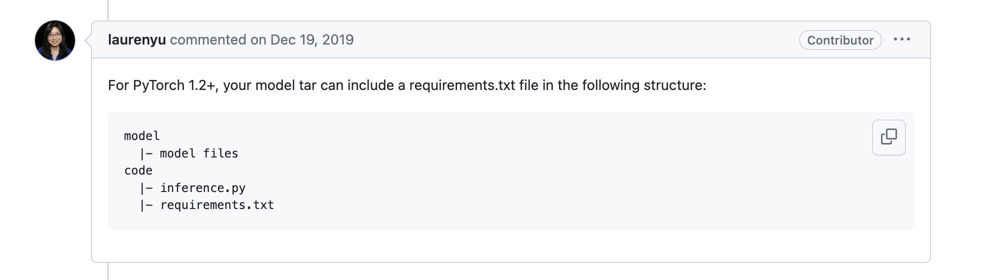

In [80]:
sm_client = boto3.client("sagemaker")
submit_dir = f"s3://{bucket}/{prefix}"
model_artifacts = f"s3://{bucket}/{prefix}/{key}"

In [81]:
s3 = boto3.client('s3')
with open('model.tar.gz', 'wb') as f:
    s3.download_fileobj(bucket, f'{prefix}/{key}', f)

with tarfile.open(key, 'r:gz') as tar:
    tar.extractall('extracted_tar')

if not os.path.exists('extracted_tar/code'):
    print("Add /code dir to tarball")
    with tarfile.open(key, "w:gz") as tar:
        for fn in os.listdir('extracted_tar'):
            p = os.path.join('extracted_tar', fn)
            tar.add(p, arcname=fn)
        tar.add('requirements.txt', arcname='code/requirements.txt')
        tar.add('sm-catboost-infer.py', arcname='code/sm-catboost-infer.py')

Add /code dir to tarball


In [82]:
with open("model.tar.gz", "rb") as f:
    s3.upload_fileobj(f, bucket, f'{prefix}/{key}')

In [87]:
create_model_resp = sm_client.create_model(
    ModelName   = 'test-pytorch',
    Containers  = [
        {
            "Image"         : inference_image_uri,
            "Mode"          : "SingleModel",
            "ModelDataUrl"  : model_artifacts,
            "Environment"   : {
                'SAGEMAKER_SUBMIT_DIRECTORY': model_artifacts,
                'SAGEMAKER_PROGRAM': 'sm-catboost-infer.py',
                'SAGEMAKER_REQUIREMENTS': 'requirements.txt' # This var only doesn't work
            } 
        }
    ],
    ExecutionRoleArn = aws_role,
)

In [88]:
transformer = inference_estimator.transformer(
    model_name='test-pytorch', strategy='SingleRecord',
    instance_count=1, instance_type="ml.m5.large", assemble_with="Line", 
    accept="text/csv" , output_path=f's3://{bucket}/cat-boost-test-pytorch'
)

In [89]:
test_data_path = 's3://jumpstart-cache-prod-ap-southeast-1/training-datasets/tabular_multiclass/validation/data.csv'

In [ ]:
transformer.transform(test_data_path, content_type="text/csv", split_type="Line")
print("Waiting for transform job: " + transformer.latest_transform_job.job_name)
transformer.wait()

INFO:sagemaker:Creating transform job with name: pytorch-inference-2023-07-01-12-56-40-560


............................Collecting catboost
2023-07-01 13:01:41,707 [INFO ] main org.pytorch.serve.servingsdk.impl.PluginsManager - Initializing plugins manager...
2023-07-01 13:01:41,915 [INFO ] main org.pytorch.serve.ModelServer - 
Torchserve version: 0.4.2
TS Home: /opt/conda/lib/python3.8/site-packages
Current directory: /
Temp directory: /home/model-server/tmp
Number of GPUs: 0
Number of CPUs: 2
Max heap size: 974 M
Python executable: /opt/conda/bin/python3.8
Config file: /etc/sagemaker-ts.properties
Inference address: http://0.0.0.0:8080
Management address: http://0.0.0.0:8080
Metrics address: http://127.0.0.1:8082
Model Store: /.sagemaker/ts/models
Initial Models: model.mar
Log dir: /logs
Metrics dir: /logs
Netty threads: 0
Netty client threads: 0
Default workers per model: 2
Blacklist Regex: N/A
Maximum Response Size: 6553500
Maximum Request Size: 6553500
Prefer direct buffer: false
Allowed Urls: [file://.*|http(s)?://.*]
2023-07-01 13:01:41,707 [INFO ] main org.pytorch.ser